In [1]:
## Import Required Library
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from shapely.geometry import Point
import plotly.express as px
import warnings
warnings.filterwarnings("ignore")

In [2]:
## Import Data from CSV

In [3]:
df_lumpy = pd.read_csv("Lumpy skin disease data.csv")

In [4]:
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)

In [5]:
## Check data whether it loads or not
df_lumpy.head()

,x,y,region,country,reportingDate,cld,dtr,frs,pet,pre,tmn,tmp,tmx,vap,wet,elevation,dominant_land_cover,X5_Ct_2010_Da,X5_Bf_2010_Da,lumpy
0,90.380931,22.437184,Asia,Bangladesh,10/9/2020,41.6,12.8,0.00,2.3,1.7,12.7,19.1,25.5,15.7,0.00,147,2,27970.983100,3691.746950,1
1,87.854975,22.986757,Asia,India,20/12/2019,40.5,13.3,0.00,2.4,0.0,13.2,19.8,26.5,16.3,0.00,145,2,25063.646690,671.326701,1
2,85.279935,23.610181,Asia,India,20/12/2019,27.3,13.6,0.08,2.3,0.6,9.4,16.2,23.0,13.0,0.98,158,2,6038.477155,1426.839831,1
3,81.564510,43.882221,Asia,China,25/10/2019,45.3,12.8,31.00,0.4,8.8,-22.5,-16.1,-9.7,0.9,4.64,178,2,760.703340,0.000000,1
4,81.161057,43.834976,Asia,China,25/10/2019,38.8,13.2,31.00,0.4,10.5,-20.4,-13.8,-7.2,1.2,1.69,185,3,270.367426,0.000000,1


In [6]:
df_lumpy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24803 entries, 0 to 24802
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   x                    24803 non-null  float64
 1   y                    24803 non-null  float64
 2   region               3039 non-null   object 
 3   country              3039 non-null   object 
 4   reportingDate        3039 non-null   object 
 5   cld                  24803 non-null  float64
 6   dtr                  24803 non-null  float64
 7   frs                  24803 non-null  float64
 8   pet                  24803 non-null  float64
 9   pre                  24803 non-null  float64
 10  tmn                  24803 non-null  float64
 11  tmp                  24803 non-null  float64
 12  tmx                  24803 non-null  float64
 13  vap                  24803 non-null  float64
 14  wet                  24803 non-null  float64
 15  elevation            24803 non-null 

In [7]:
### Dataset details
# 1.data loads successfully
# 2.In the dataset we have total 24803 data-points and 19 dependent features and 1 independent/Target feature. (While data pre-processing we will ignore some of the unwanted features depends on the analysis)
# 3.Here we have 3 types of data (int,float and object/categorical)
# 4. 14 features have float type , 2 features have int type and 3 are object / categorical type data.
# 5. the data acquire 3.8+ MB machine memory.
# 6.The x and y feature looks like it is Latitude and Longitude geocoded. For better understanding, let rename the columns/features x to Longitude and y to Latitude.

In [8]:
# Rename the features
df_lumpy.rename(columns={"x":"Longitude" , "y":"Latitude"},inplace=True,errors="raise")

In [9]:
geolocation = df_lumpy[['Latitude','Longitude','country']]
geolocation.head()

,Latitude,Longitude,country
0,22.437184,90.380931,Bangladesh
1,22.986757,87.854975,India
2,23.610181,85.279935,India
3,43.882221,81.564510,China
4,43.834976,81.161057,China


In [10]:
#fig = px.scatter_geo(geolocation,lat='Latitude',lon='Longitude')
#fig.update_layout(title = 'Lumpy Skin Disease Area', title_x=0.5)
#fig.show()

In [11]:
# 1.Above we plot the the map using Latitude and Longitude geocode. The blue area in map show that the spread Lumpy disease.
# 2.we can see that the disease are in almost all the countries.

### Exploratory Data Analysis

In [12]:
## Check the Data describtion
df_lumpy.describe()

,Longitude,Latitude,cld,dtr,frs,pet,pre,tmn,tmp,tmx,vap,wet,elevation,dominant_land_cover,X5_Ct_2010_Da,X5_Bf_2010_Da,lumpy
count,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000,24803.000000
mean,79.221374,46.370056,59.452159,9.107777,23.978048,0.803487,26.271137,-15.794755,-11.227807,-6.681212,3.728230,8.542482,164.769302,4.416119,629.129412,170.306057,0.122526
std,43.338530,19.220555,19.423029,2.988448,11.518315,1.172915,33.630747,17.587685,17.989715,18.540915,4.952353,6.205199,19.679197,2.406231,2279.198775,1127.977653,0.327898
min,-179.750000,-28.750000,0.000000,2.000000,0.000000,0.000000,0.000000,-52.100000,-48.100000,-44.200000,0.000000,0.000000,66.000000,0.000000,0.000000,0.000000,0.000000
25%,45.083150,34.750000,43.800000,6.800000,23.210000,0.000000,5.900000,-30.100000,-25.500000,-20.900000,0.400000,3.000000,152.000000,3.000000,2.513366,0.000000,0.000000
50%,80.750000,48.250000,62.300000,8.300000,31.000000,0.200000,14.700000,-19.100000,-14.200000,-9.700000,1.500000,8.020000,161.000000,4.000000,43.383823,0.000197,0.000000
75%,109.750000,61.750000,75.300000,11.100000,31.000000,1.100000,33.400000,-2.200000,1.400000,4.900000,4.800000,12.710000,176.000000,4.000000,386.124908,0.002094,0.000000
max,179.750000,81.750000,98.700000,20.600000,31.000000,7.500000,341.900000,23.900000,28.500000,36.400000,28.600000,30.920000,249.000000,11.000000,167388.672700,56654.780150,1.000000


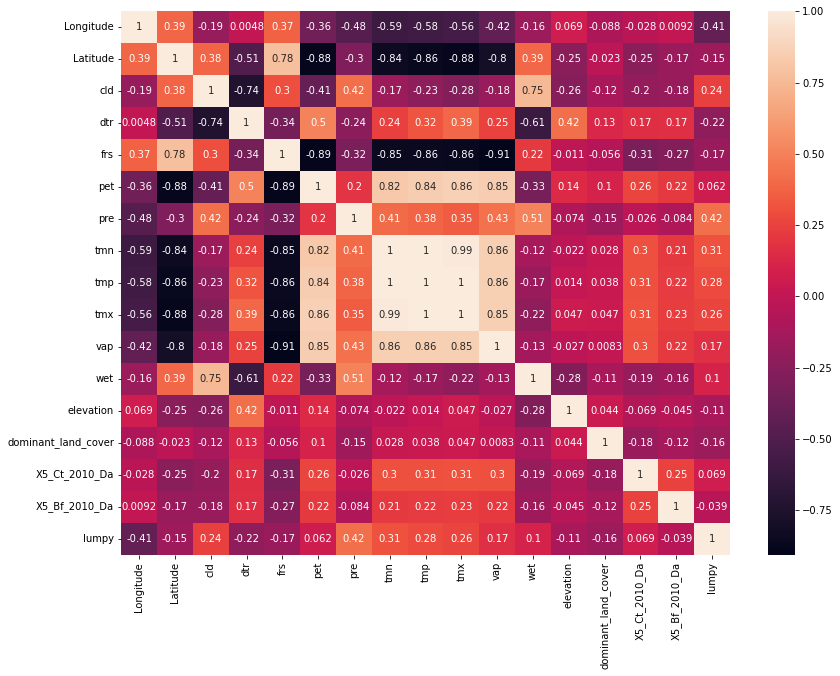

In [13]:
## Check the co-rrelation 
plt.figure(figsize=(30,10))
plt.subplot(121)
sns.heatmap(df_lumpy.corr(),annot=True)
plt.show()

## Univarient Data Analysis

In [14]:
df_lumpy.head()
df_lumpy.style.highlight_null(null_color='red')

In [15]:
## 1.region
df_lumpy['region'].value_counts()

Europe    2172
Asia       777
Africa      90
Name: region, dtype: int64

In [16]:
## From above values Count function we can say that,
# 1.there are 3 region where that Lumpy skin disease spreads.
# 2.From 3 regions
    # 1.On First place Europen Countries (2172) are highly suffered from Lumpy Skin Disease.
    # 2.On Second place Asian Countries (777)  are suffered from Lumpy Skin Disease. 
    # 3.On Third place African Countries (90)  are suffered from Lumpy Skin Disease. 
# 3.So Europen Countriers are quite not safe for animals and Countries should take the appropriate action.    

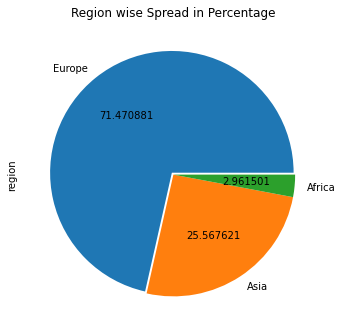

In [17]:
plt.figure(figsize=(12,40))
plt.subplot(121)
df_lumpy['region'].value_counts().plot.pie(autopct="%2f",explode=(0.02,0,0),title = "Region wise Spread in Percentage")
plt.show()

### 2.Country

In [18]:
df_lumpy['country'].nunique()
# 1.There are total 37 country who are suffered by Lumy Skin Disease which are belongs to 

37

In [19]:
pd.DataFrame(df_lumpy['country'].unique())

,0
0,Bangladesh
1,India
2,China
3,Israel
4,Russian Federation
5,West Bank
6,Syrian Arab Republic
7,Georgia
8,Namibia
9,Montenegro


In [20]:
## These are the countries in which the disease found

<AxesSubplot:xlabel='region,country'>

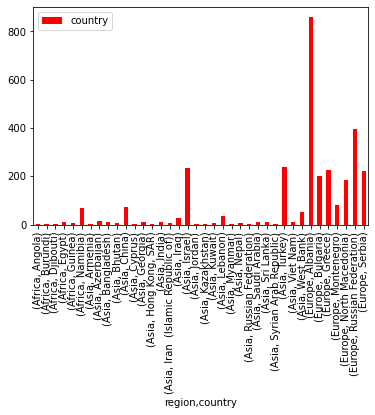

In [21]:
pd.DataFrame(df_lumpy.groupby(['region','country'])['country'].count()).plot(kind="bar",color="red")

In [22]:
pd.DataFrame(df_lumpy.groupby(['region','country'])['country'].count()).rename(columns={'country' : "CountryCount"}) ##.sort_values(by="CountryCount",ascending=False)

CountryCount
region country                                  
Africa Angola                                  1
       Burundi                                 2
       Djibouti                                1
       Egypt                                  12
       Guinea                                  6
       Namibia                                68
Asia   Armenia                                 1
       Azerbaijan                             16
       Bangladesh                             11
       Bhutan                                  8
       China                                  71
       Cyprus                                  2
       Georgia                                10
       Hong Kong, SAR                          1
       India                                  12
       Iran  (Islamic Republic of)             5
       Iraq                                   28
       Israel                                233
       Jordan                                  2
       Kazakhstan                              2
       Kuwait                                  5
       Lebanon                                34
       Myanmar                                 1
       Nepal                                   8
       Russian Federation                      4
       Saudi Arabia                           10
       Sri Lanka                              12
       Syrian Arab Republic                    3
       Turkey                                237
       Viet Nam                               11
       West Bank                              50
Europe Albania                               858
       Bulgaria                              202
       Greece                                226
       Montenegro                             82
       North Macedonia                       186
       Russian Federation                    395
       Serbia                                223

In [23]:
## From above table
# 1. From Europe region Top 3 Countries those are higly suffered from Lump skin disease are :
     # 1.Albania - total 858  cases are reported.
     # 2.Russian Federation - total 395 cases are reported.
     # 3.Greece - total 226 - cases are reported.    
    
# 2. From Asian region Top 3 Countries those are higly suffered from Lump skin disease are :    
     # 1.Turkey - Total 237 cases are reported
     # 2.Israel -Total 233 cases are reported.
     # 3.China - Total 71 Cases are reported.   
    
# 3. From African regio Top 3 Countries those are highly suffered from Lump skin disease are :
    # 1.Namibia - Total 68 cases are reported.
    # 2.Egypt -Total 12 cases are reported.
    # 3.Guinea -Total 6 cases are reported.
    
## From above analysis we can say that these countries need to take immediate action.
   ## 1.If it doest not take any action then may be it spread and those animals also get suffered who are not in present time.
    
## Impact :
   ## 1.If they dont take any action they definaly it will spread and the animals will died and the population of animals (cow) would be decreased.
   ## 2.If they population would decrease then those countries would not able to get the milk and milk productions
   ## 3.beacuse of these they need to import it from other countries and then it would be very expensive and if this happends then it will directly impact on ecomomy.
    

## Reporting Date

In [24]:
df_lumpy['reportingDate'] =pd.to_datetime(df_lumpy['reportingDate'])

In [25]:
df_lumpy['Year'] = df_lumpy['reportingDate'].dt.year

In [26]:
pd.DataFrame(df_lumpy['Year'].value_counts().sort_values(ascending=True)).rename(columns={"Year" : "Case Report Count"})

,Case Report Count
2011.0,6
2021.0,12
2012.0,40
2019.0,91
2020.0,95
2018.0,100
2015.0,139
2017.0,249
2013.0,251
2014.0,307


### 1.Year  Wise Cases

<AxesSubplot:>

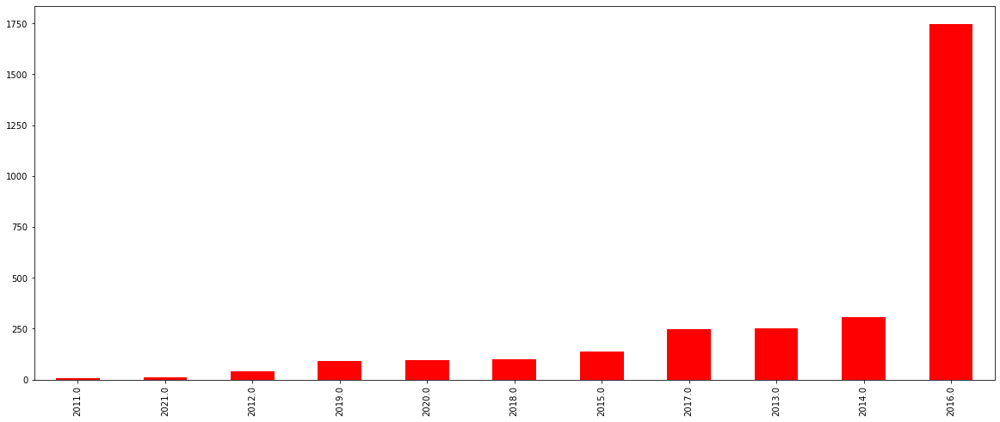

In [27]:
plt.figure(figsize=(20,8))
df_lumpy[df_lumpy['Year'] == df_lumpy['Year']]['Year'].value_counts().sort_values(ascending=True).plot(kind="bar",color="red")

In [28]:
## Obervations from reporting Date
 # 1.First report was registered in 2011.(Based on the data which we have we can say that the first case reported in 2011 year.Indirectly it was born in 2011)
 # 2.After 2011 we can see continuously the reportes were increasing every year.
 # 3.In 2016, the cases of this disease are very high and after 2016 its show like the cases counts were decreased.

In [29]:
df_lumpy.head()

,Longitude,Latitude,region,country,reportingDate,cld,dtr,frs,pet,pre,tmn,tmp,tmx,vap,wet,elevation,dominant_land_cover,X5_Ct_2010_Da,X5_Bf_2010_Da,lumpy,Year
0,90.380931,22.437184,Asia,Bangladesh,2020-10-09,41.6,12.8,0.00,2.3,1.7,12.7,19.1,25.5,15.7,0.00,147,2,27970.983100,3691.746950,1,2020.0
1,87.854975,22.986757,Asia,India,2019-12-20,40.5,13.3,0.00,2.4,0.0,13.2,19.8,26.5,16.3,0.00,145,2,25063.646690,671.326701,1,2019.0
2,85.279935,23.610181,Asia,India,2019-12-20,27.3,13.6,0.08,2.3,0.6,9.4,16.2,23.0,13.0,0.98,158,2,6038.477155,1426.839831,1,2019.0
3,81.564510,43.882221,Asia,China,2019-10-25,45.3,12.8,31.00,0.4,8.8,-22.5,-16.1,-9.7,0.9,4.64,178,2,760.703340,0.000000,1,2019.0
4,81.161057,43.834976,Asia,China,2019-10-25,38.8,13.2,31.00,0.4,10.5,-20.4,-13.8,-7.2,1.2,1.69,185,3,270.367426,0.000000,1,2019.0


In [30]:
df_lumpy['Month'] = df_lumpy['reportingDate'].dt.month
df_lumpy['MonthTitle']= df_lumpy['reportingDate'].dt.month_name()

### 2. Year and Month Wise Cases

In [31]:
pd.DataFrame(df_lumpy.groupby(['Year','Month'])['Month'].count()).rename(columns={'Month':'CaseCounts'})

CaseCounts
Year   Month            
2011.0 7.0             1
       10.0            3
       11.0            2
2012.0 5.0             4
       7.0             2
       8.0             6
       9.0             2
       10.0            6
       11.0           11
       12.0            9
2013.0 1.0             1
       2.0             4
       3.0            14
       4.0            57
       5.0             8
       7.0           138
       8.0             1
       9.0             4
       11.0           17
       12.0            7
2014.0 1.0            38
       2.0             4
       3.0            10
       4.0            54
       5.0            33
       6.0            32
       7.0            93
       8.0            13
       9.0             6
       10.0           19
       11.0            2
       12.0            3
2015.0 1.0             1
       2.0             6
       3.0             2
       4.0            10
       5.0             1
       8.0            18
       9.0            73
       10.0           28
2016.0 1.0            72
       2.0            57
       3.0            19
       4.0            95
       5.0           232
       6.0           225
       7.0           334
       8.0           180
       9.0           276
       10.0          108
       11.0           97
       12.0           54
2017.0 1.0            36
       2.0            16
       3.0            12
       4.0            16
       5.0            21
       6.0            49
       7.0            36
       8.0            34
       9.0             4
       10.0           13
       11.0            4
       12.0            8
2018.0 1.0            30
       3.0            15
       5.0             2
       7.0            23
       8.0             9
       9.0            11
       10.0            5
       11.0            3
       12.0            2
2019.0 3.0             2
       4.0             8
       6.0             3
       7.0            14
       8.0            16
       9.0            15
       10.0           22
       11.0            3
       12.0            8
2020.0 3.0             1
       4.0             1
       5.0             1
       6.0             2
       7.0            13
       8.0            27
       9.0            18
       10.0           14
       11.0            7
       12.0           11
2021.0 1.0            12

In [32]:
df_lumpy.pivot_table(index=['Month','MonthTitle'],columns=['Year','region'],values=['lumpy'],aggfunc='count')

lumpy                                                  \
Year             2011.0 2012.0 2013.0        2014.0       2015.0          
region           Africa   Asia Africa   Asia Africa  Asia   Asia Europe   
Month MonthTitle                                                          
1.0   January       NaN    NaN    NaN    1.0    NaN  38.0    1.0    NaN   
2.0   February      NaN    NaN    NaN    4.0    NaN   4.0    NaN    6.0   
3.0   March         NaN    NaN    NaN   14.0    NaN  10.0    NaN    2.0   
4.0   April         NaN    NaN    NaN   57.0    NaN  54.0    2.0    8.0   
5.0   May           NaN    4.0    NaN    8.0    NaN  33.0    1.0    NaN   
6.0   June          NaN    NaN    NaN    NaN    NaN  32.0    NaN    NaN   
7.0   July          1.0    2.0    NaN  138.0    NaN  93.0    NaN    NaN   
8.0   August        NaN    6.0    1.0    NaN    NaN  13.0    3.0   15.0   
9.0   September     NaN    2.0    NaN    4.0    6.0   NaN    4.0   69.0   
10.0  October       3.0    6.0    NaN    NaN    NaN  19.0    NaN   28.0   
11.0  November      2.0   11.0    NaN   17.0    NaN   2.0    NaN    NaN   
12.0  December      NaN    9.0    6.0    1.0    NaN   3.0    NaN    NaN   

                                                                           \
Year             2016.0             2017.0             2018.0               
region           Africa Asia Europe Africa Asia Europe Africa Asia Europe   
Month MonthTitle                                                            
1.0   January       2.0  1.0   69.0    NaN  NaN   36.0    NaN  NaN   30.0   
2.0   February      NaN  2.0   55.0    NaN  NaN   16.0    NaN  NaN    NaN   
3.0   March         NaN  NaN   19.0    4.0  NaN    8.0    NaN  3.0   12.0   
4.0   April         NaN  NaN   95.0   10.0  NaN    6.0    NaN  NaN    NaN   
5.0   May           NaN  NaN  232.0    1.0  NaN   20.0    NaN  NaN    2.0   
6.0   June          NaN  NaN  225.0    3.0  NaN   46.0    NaN  NaN    NaN   
7.0   July          4.0  6.0  324.0   15.0  1.0   20.0   10.0  NaN   13.0   
8.0   August        NaN  2.0  178.0   19.0  NaN   15.0    NaN  1.0    8.0   
9.0   September     2.0  NaN  274.0    NaN  NaN    4.0    NaN  NaN   11.0   
10.0  October       NaN  NaN  108.0    NaN  NaN   13.0    NaN  1.0    4.0   
11.0  November      NaN  NaN   97.0    NaN  NaN    4.0    NaN  1.0    2.0   
12.0  December      NaN  NaN   54.0    NaN  NaN    8.0    NaN  NaN    2.0   

                                                    
Year             2019.0        2020.0       2021.0  
region             Asia Europe Africa  Asia   Asia  
Month MonthTitle                                    
1.0   January       NaN    NaN    NaN   NaN   12.0  
2.0   February      NaN    NaN    NaN   NaN    NaN  
3.0   March         1.0    1.0    NaN   1.0    NaN  
4.0   April         5.0    3.0    NaN   1.0    NaN  
5.0   May           NaN    NaN    NaN   1.0    NaN  
6.0   June          2.0    1.0    NaN   2.0    NaN  
7.0   July         10.0    4.0    NaN  13.0    NaN  
8.0   August        4.0   12.0    NaN  27.0    NaN  
9.0   September     9.0    6.0    NaN  18.0    NaN  
10.0  October      21.0    1.0    NaN  14.0    NaN  
11.0  November      3.0    NaN    1.0   6.0    NaN  
12.0  December      2.0    6.0    NaN  11.0    NaN

In [33]:
## From the above pivot table we can check that in which year ,month,region wise how many cases were registered.
## the red mark defines that there were no case registered in that particular month

### 3.cld

<AxesSubplot:xlabel='cld', ylabel='Density'>

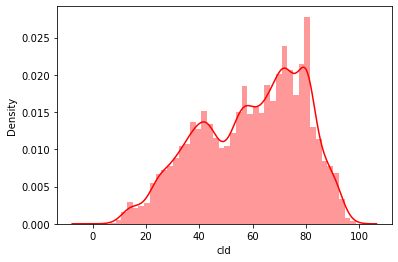

In [34]:
sns.distplot(df_lumpy['cld'],color="red")

<AxesSubplot:xlabel='cld', ylabel='Count'>

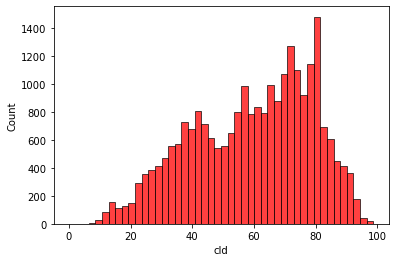

In [35]:
sns.histplot(df_lumpy['cld'],color='red')